In [1]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn

import sys
sys.path.insert(0, '/mnt/data/molchanov/dltranz')

from uplift.data import *
from uplift.models import *
from uplift.constants import *
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

from sklearn.manifold import TSNE
import tqdm

%matplotlib inline

model _params:
        CURRENT_PARAMS criteo_metric_learning
        N_AUGMENTS 5
        LEARNING_RATE 0.002
        GAMMA 0.9025
        BATCH_SIZE 128
        EPOCHS 25
        SAMPLING_STRATEGY HardNegativePair
        NEGATIVES_COUNT 5
        MARGING 0.5
        STEP_SIZE 1
        MODEL_POSTFIX criteo_metrlearn
        ADD_INFO {'losses': [{'name': 'ContrastiveLossOriginal', 'marging': 0.5, 'neg_count': 5, 'sampling_strategy': 'HardNegativePair'}], 'augment_type': 'perceptron', 'hiden_size': 64}
        ERROR_RATE 0.5
       


In [2]:
train_loader, test_loader = get_criteo_data_loaders(batch_size=128, n_augments=1, augment_labels=False)
sample = next(iter(train_loader))

use perceptron dataset


In [3]:
model = get_criteo_metriclearn_model()
model

use perceptrom model


Sequential(
  (0): LambdaLayer()
  (1): Linear(in_features=13, out_features=128, bias=True)
  (2): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): ReLU()
  (4): Linear(in_features=128, out_features=64, bias=True)
  (5): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (6): ReLU()
  (7): Linear(in_features=64, out_features=8, bias=True)
  (8): L2Normalization()
)

In [8]:
inputs = []
embeddings = []
labels = []

with torch.no_grad():
    with tqdm.notebook.tqdm(total=len(train_loader)) as steps:
        for itr, data in enumerate(train_loader):
            x, y = data[0], data[1]
            out = model(x)

            out = out.detach().cpu()
            y = y.cpu()
            
            inputs.append(x.detach().cpu().view(-1, x.size(-1)))
            embeddings.append(out.detach().cpu())
            labels.append(y.detach().cpu())
            
            steps.update()

inputs = torch.cat(inputs, dim=0).numpy()
embeddings = torch.cat(embeddings, dim=0).numpy()
labels = torch.cat(labels, dim=0).view(-1).numpy()
            
print(f'inputs shape {inputs.shape}')
print(f'embeddings shape {embeddings.shape}')
print(f'labels shape {labels.shape}')


inputs shape (51474, 13)
embeddings shape (51474, 8)
labels shape (51474,)


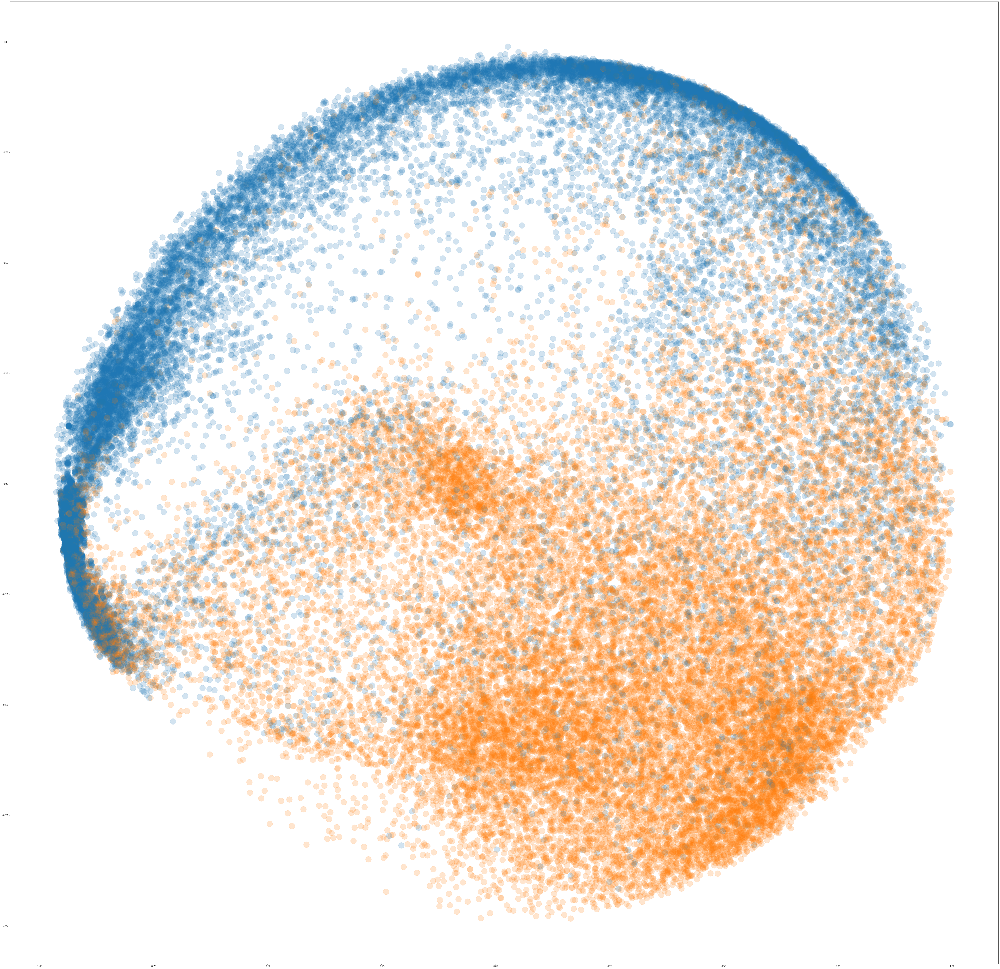

In [11]:
#X_embedded = TSNE(n_components=2).fit_transform(embeddings)
X_embedded = PCA(n_components=2).fit_transform(embeddings)

colors = [col for col in mcolors.TABLEAU_COLORS]
cl = [colors[lbl] for lbl in labels]

plt.figure(figsize=(80,80))
ax1 = plt.subplot()
ax1.scatter(X_embedded[:, 0], X_embedded[:, 1], s=700, c=cl, alpha=0.2)

#ax1.scatter(X_centroids[:, 0], X_centroids[:, 1], s=3700, c='black', marker='X')

plt.show()

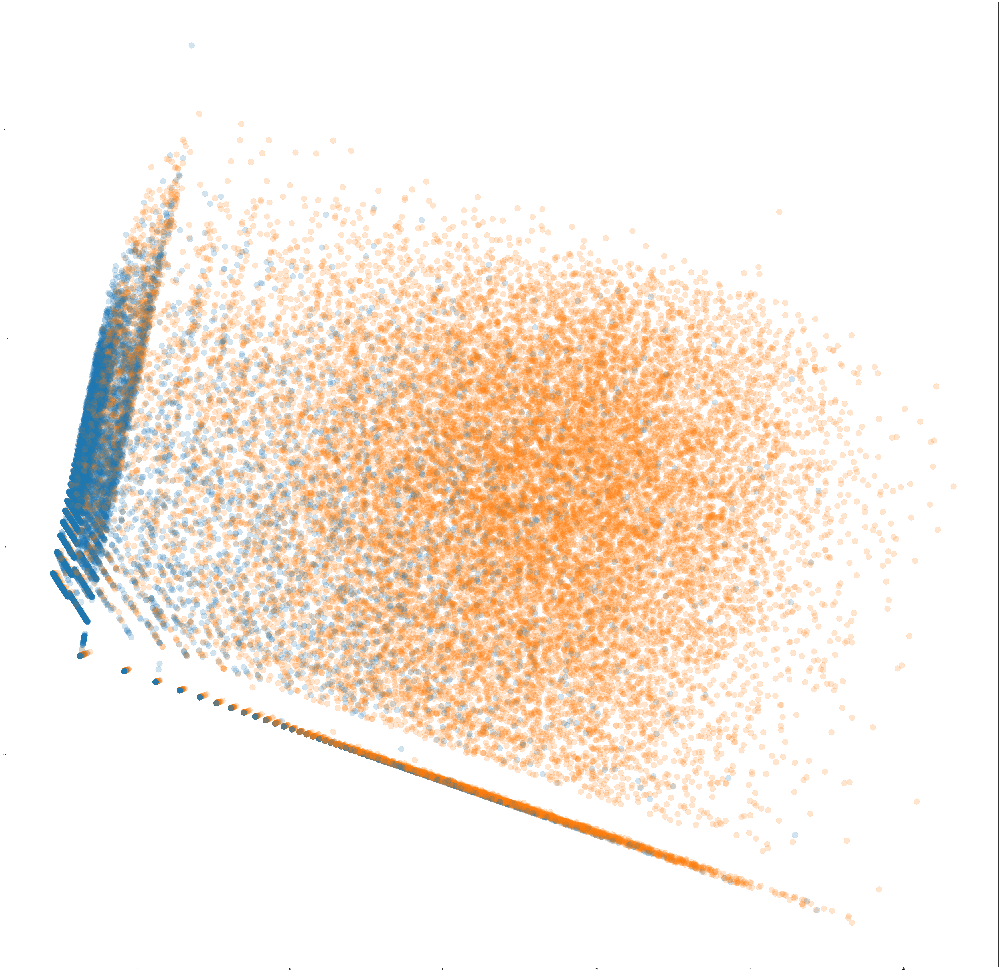

In [10]:
from sklearn.decomposition import PCA
X_inputs = PCA(n_components=2).fit_transform(inputs)
#X_inputs = TSNE(n_components=2).fit_transform(inputs)

colors = [col for col in mcolors.TABLEAU_COLORS]
cl = [colors[lbl] for lbl in labels]

plt.figure(figsize=(80,80))
ax1 = plt.subplot()
ax1.scatter(X_inputs[:, 0], X_inputs[:, 1], s=700, c=cl, alpha=0.2)

#ax1.scatter(X_centroids[:, 0], X_centroids[:, 1], s=3700, c='black', marker='X')

plt.show()

In [15]:
loader, _ = get_criteo_data_loaders(batch_size=128, n_augments=10, augment_labels=False)
sample = next(iter(loader))
out = model(sample[0])
out.size()

use perceptron dataset


torch.Size([1280, 8])

In [22]:
x0, x1 = out[:10, :].detach().cpu(), out[10:, :].detach().cpu()
x0.size(), x1.size()

(torch.Size([10, 8]), torch.Size([1270, 8]))

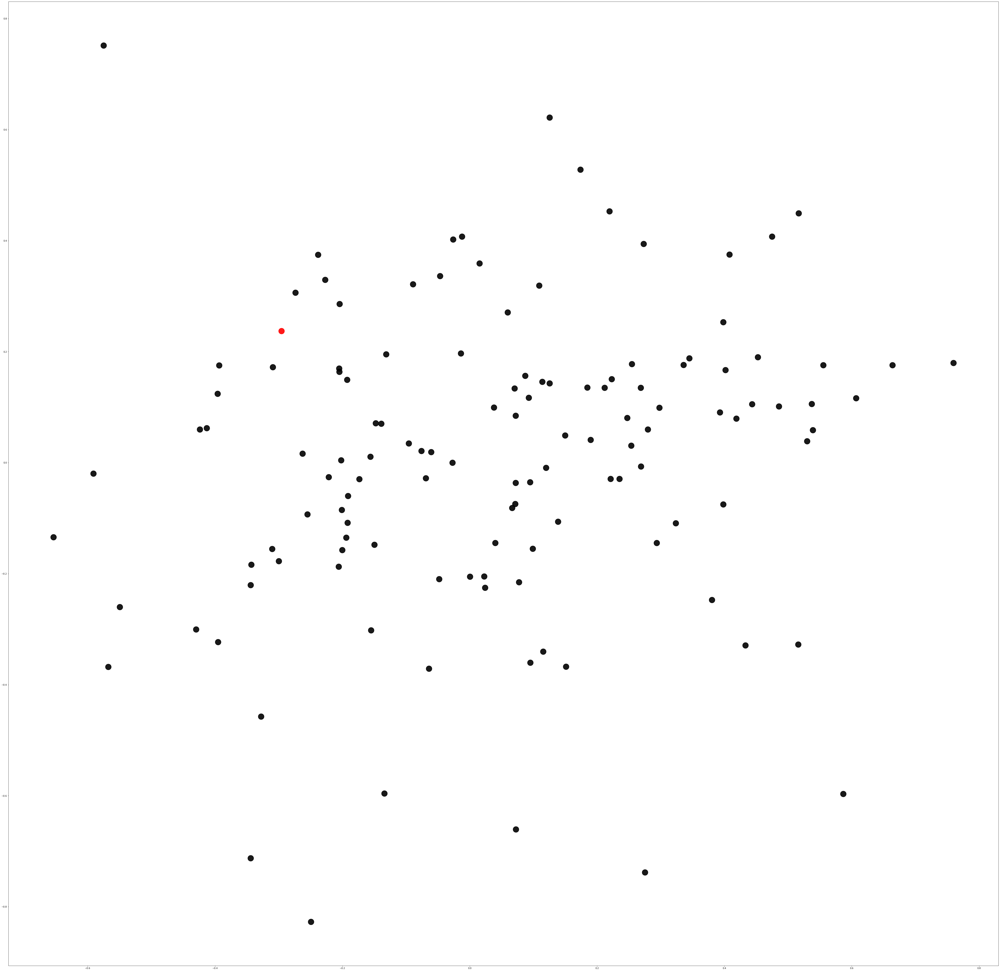

In [24]:
plt.figure(figsize=(80,80))
ax1 = plt.subplot()
ax1.scatter(x0[:, 0], x0[:, 1], s=700, c='red', alpha=0.2)
ax1.scatter(x1[:, 0], x1[:, 1], s=700, c='black', alpha=0.2)

from uplift.losses import *